In [1]:
import itertools
import logging
import warnings
import re
from pathlib import Path
from pprint import pprint

import numpy as np
import pytorch_lightning as pl
import torch
from torch import Tensor
from torchvision.utils import make_grid
from matplotlib import pyplot as plt
from pytorch_lightning import loggers as pl_loggers
from pytorch_lightning.callbacks import RichProgressBar, ModelCheckpoint

In [2]:
from zprp.models.cycle_gan.data import CycleGanDataModule
from zprp.models.cycle_gan.model import CycleGAN
from zprp.models.cycle_gan.components import SemanticRegularization

Setup common data paths:

In [3]:
DATA_PATH = Path("../data")
CONTENT_PATH = DATA_PATH / "photo/0"
STYLE_PATH = DATA_PATH / "monet/0"

In [4]:
device = torch.device("cuda") if torch.cuda.is_available else torch.device("cpu")

In [5]:
def unnormalize(x: torch.Tensor) -> torch.Tensor:
    return (x * 0.5) + 0.5

## Regularization experiment

In [6]:
regularization_log_dir = Path("../models/regularization/lightning_logs")

In [7]:
lambdas = [0, 0.5, 1, 2]
betas = [10 ** (-2), 10 ** (-1), 1, 10]
epochs = 30

In [8]:
lambda_dirs = {
    lambda_value: regularization_log_dir / f"cyclegan_regularization_experiment_l{lambda_value}"
    for lambda_value in lambdas
}
# Map (lambda, beta) pairs to checkpoint paths. Betas are stored as subsequent `version`s, use last n
lambdas_betas_checkpoints = dict(
    itertools.chain(
        *[
            [
                (
                    (lambda_value, beta_value),
                    max(
                        (version_dir / "checkpoints").iterdir(),
                        key=lambda p: int(re.search(f"epoch=[0-9]{{{len(betas)}}}", str(p)).group()[-len(betas) :]),
                    ),
                )
                for beta_value, version_dir in zip(betas, list(sorted(lambda_dir.iterdir())[-len(betas) :]))
            ]
            for lambda_value, lambda_dir in lambda_dirs.items()
        ]
    )
)

print("\n".join([f"Lambda={l:<4} beta={b:<4}  {dir}" for (l, b), dir in lambdas_betas_checkpoints.items()]))

Lambda=0    beta=0.01  ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0    beta=0.1   ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0    beta=1     ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0    beta=10    ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0/version_4/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0.5  beta=0.01  ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0.5/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0.5  beta=0.1   ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l0.5/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Lambda=0.5  beta=1     ../models/regulariz

In [44]:
dm = CycleGanDataModule(content_path=CONTENT_PATH, style_path=STYLE_PATH, n_val_images=64, batch_size=16, img_size=256, random_seed=834)
dm.setup("fit")

In [45]:
class TestSemanticRegularization(SemanticRegularization):
    # PL only needs `TestSemanticRegularization` to be defined in current scope, the actual class
    pass

Load lightning_logs/cyclegan_lambdas_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0019.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt


/tmp/ipykernel_50418/3576618860.py:40: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


Load lightning_logs/cyclegan_lambdas_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0019.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
Load ../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt


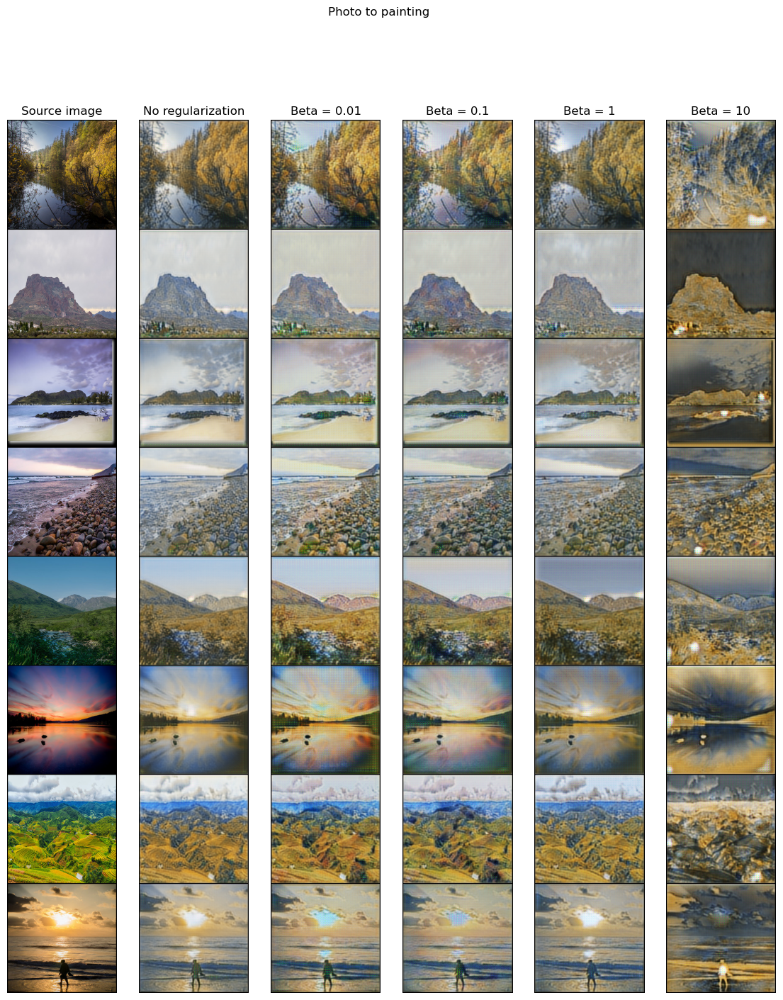

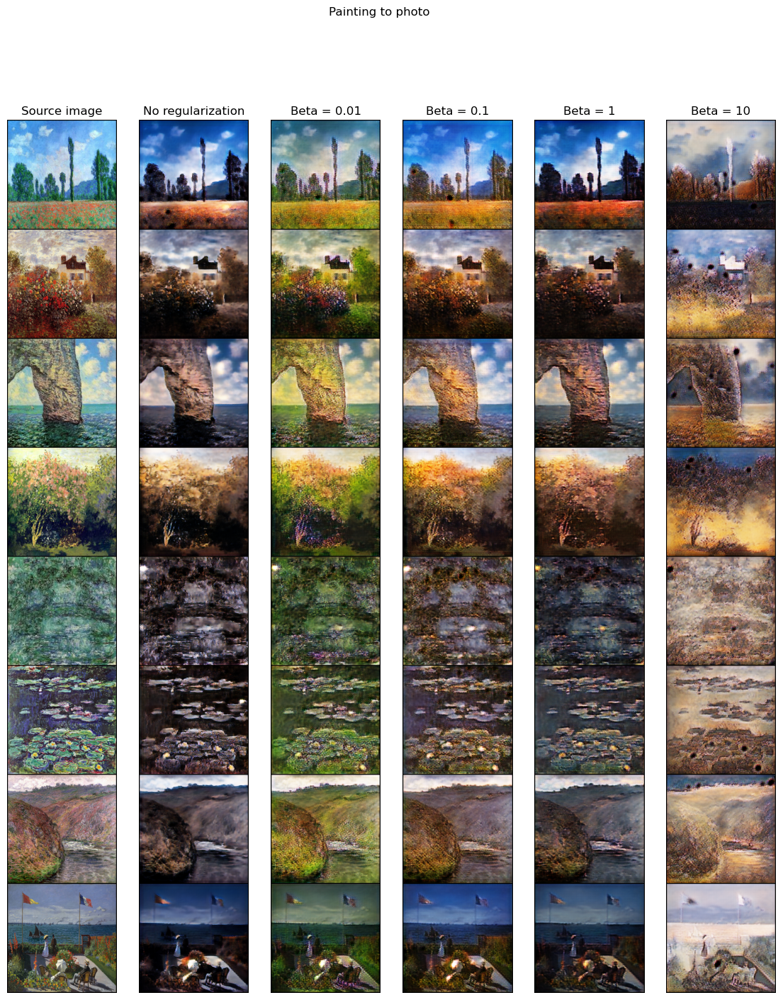

In [46]:
plt.rcParams["figure.figsize"] = (14, 16)


def compare_betas(
    no_regularization_checkpoint: Path,
    beta_checkpoints: list[Path],
    beta_values: list[float],
    images_x: Tensor,
    images_y: Tensor,
):


    for images, transfer_fun, plot_name in [
        (images_x, CycleGAN.x_to_y, "Photo to painting"),
        (images_y, CycleGAN.y_to_x, "Painting to photo"),
    ]:
        fig, axes = plt.subplots(1, 6)

        axes[0].imshow(make_grid(unnormalize(images), nrow=1).permute(1, 2, 0))
        axes[0].set_title("Source image")
        axes[0].axis("off")

        for checkpoint, subplot_name, ax in zip(
            [no_regularization_checkpoint] + beta_checkpoints,
            ["No regularization"] + [f"Beta = {b}" for b in beta_values],
            axes[1:],
        ):
            print(f"Load {checkpoint}")
            model = CycleGAN.load_from_checkpoint(checkpoint).to(device)
            model.eval()
            model.g.eval()
            model.f.eval()
            with torch.no_grad():
                ax.imshow(make_grid(unnormalize(transfer_fun(model, (images.to(device)))), nrow=1).permute(1, 2, 0).cpu())
                ax.set_title(subplot_name)
                ax.axis("off")

        fig.suptitle(plot_name)

        fig.show()


images_x, images_y = next(iter(dm.val_dataloader()))
images_x, images_y = images_x[:8], images_y[:8]
compare_betas(
    no_regularization_checkpoint=Path(
        "lightning_logs/cyclegan_lambdas_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0019.ckpt"  # TODO replace with actual checkpoints
    ),
    beta_checkpoints=[c for (l, _), c in lambdas_betas_checkpoints.items() if l == 2],
    beta_values=betas,
    images_x=images_x,
    images_y=images_y,
)

In [49]:
class TestSemanticRegularization(SemanticRegularization):
    # PL only needs `TestSemanticRegularization` to be defined in current scope, the actual class will be loaded from the checkpoint file
    pass


for (lambda_value, beta_value), checkpoint_file in lambdas_betas_checkpoints.items():
    model = CycleGAN.load_from_checkpoint(checkpoint_file)
    print(f"lambda={lambda_value}, beta={beta_value}")
    del model

/home/tomek/miniconda3/envs/zprp/lib/python3.11/site-packages/pytorch_lightning/utilities/migration/utils.py:56: The loaded checkpoint was produced with Lightning v2.2.5, which is newer than your current Lightning version: v2.2.1


lambda=0, beta=0.01
lambda=0, beta=0.1
lambda=0, beta=1
lambda=0, beta=10
lambda=0.5, beta=0.01
lambda=0.5, beta=0.1
lambda=0.5, beta=1
lambda=0.5, beta=10
lambda=1, beta=0.01
lambda=1, beta=0.1
lambda=1, beta=1
lambda=1, beta=10
lambda=2, beta=0.01
lambda=2, beta=0.1
lambda=2, beta=1
lambda=2, beta=10


In [16]:
plt.rcParams["figure.figsize"] = (14, 8)


def show_images(model, title):
    model.eval()
    model.g.eval()
    model.f.eval()

    images_x, images_y = next(iter(dm.val_dataloader()))
    images_x = images_x[:16].to(device)
    images_y = images_y[:16].to(device)

    with torch.no_grad():
        fake_y = model.x_to_y(images_x)
        cycle_x = model.y_to_x(fake_y)
        fake_x = model.y_to_x(images_y)
        cycle_y = model.x_to_y(fake_x)

    fig, axes = plt.subplots(2, 3)

    axes[0][0].imshow(make_grid(unnormalize(images_x), nrow=4).permute(1, 2, 0).cpu())
    axes[0][0].set_title("Real photo")
    axes[0][1].imshow(make_grid(unnormalize(fake_y), nrow=4).permute(1, 2, 0).cpu())
    axes[0][1].set_title("Fake painting")
    axes[0][2].imshow(make_grid(unnormalize(cycle_x), nrow=4).permute(1, 2, 0).cpu())
    axes[0][2].set_title("Recreated photo")

    axes[1][0].imshow(make_grid(unnormalize(images_y), nrow=4).permute(1, 2, 0).cpu())
    axes[1][0].set_title("Real painting")
    axes[1][1].imshow(make_grid(unnormalize(fake_x), nrow=4).permute(1, 2, 0).cpu())
    axes[1][1].set_title("Fake photo")
    axes[1][2].imshow(make_grid(unnormalize(cycle_y), nrow=4).permute(1, 2, 0).cpu())
    axes[1][2].set_title("Recreated painting")

    for ax in axes.reshape(-1):
        ax.axis("off")

    if title:
        fig.suptitle(title, size=22)

    plt.show()

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


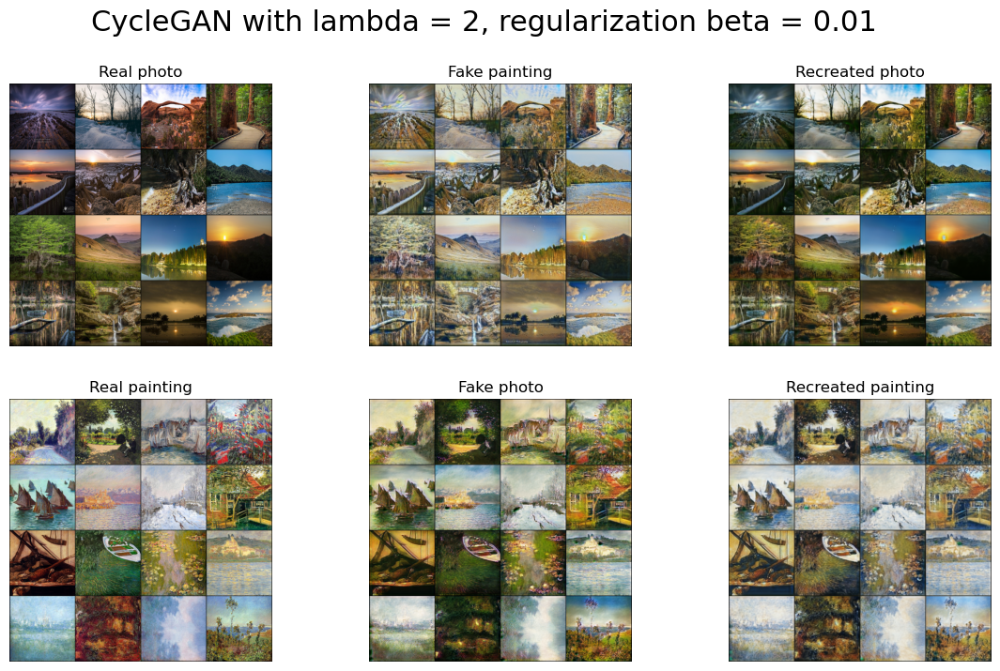

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


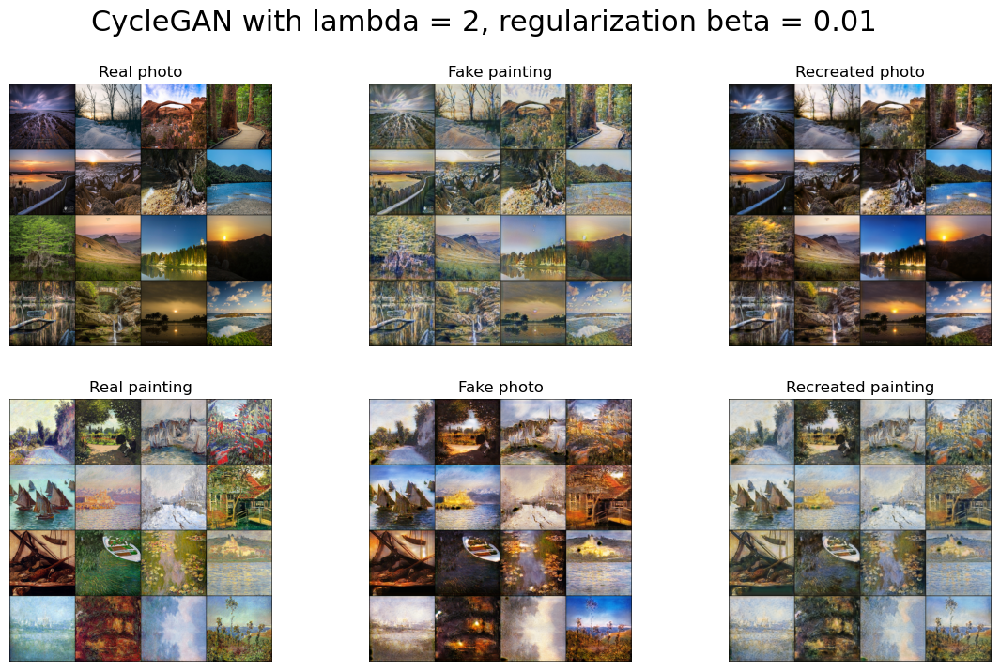

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


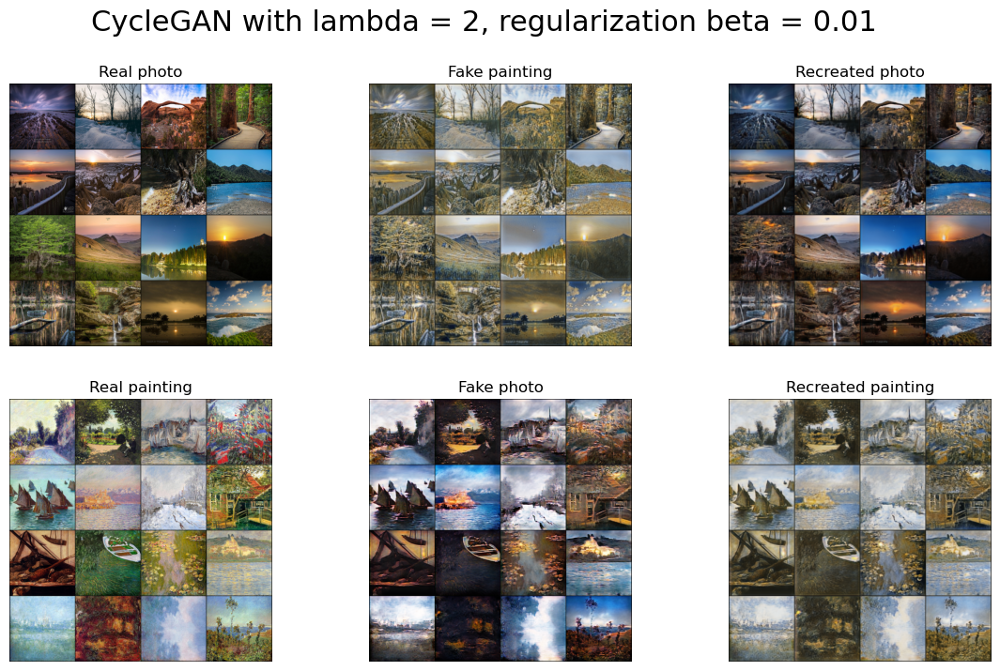

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


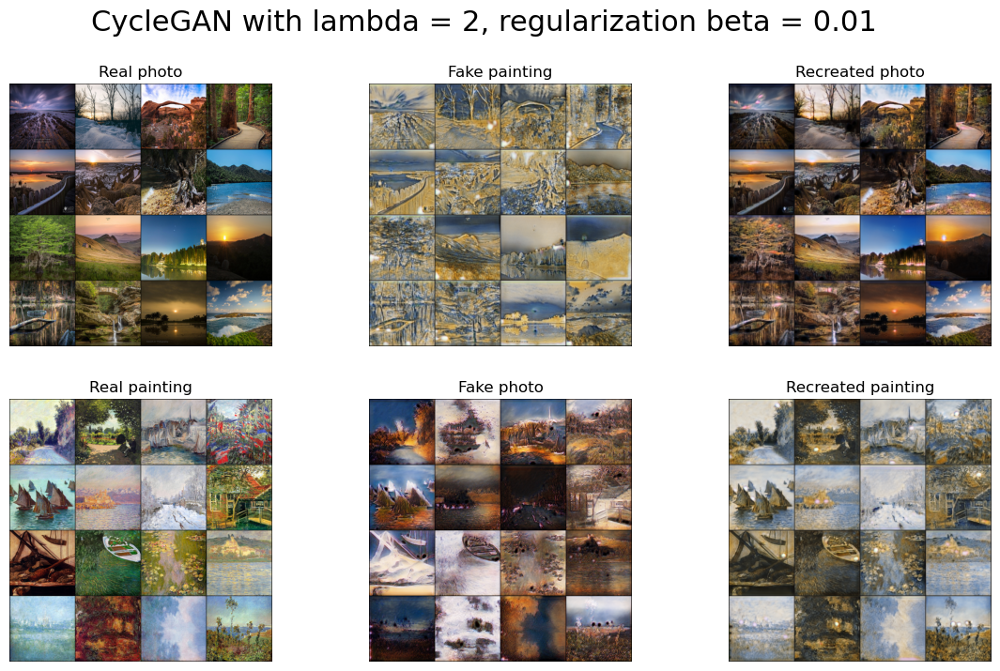

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


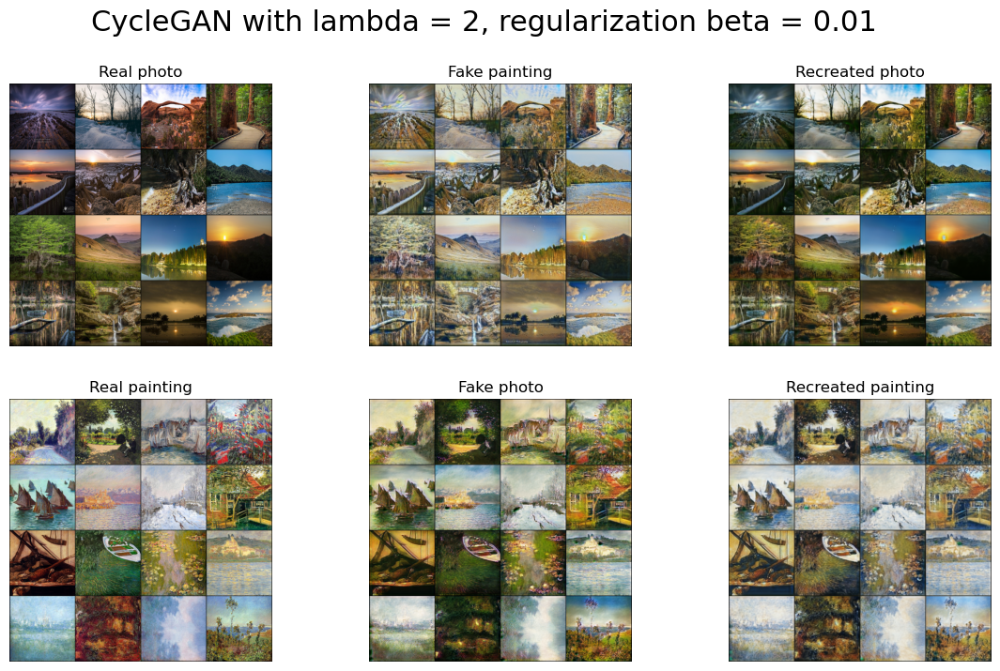

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


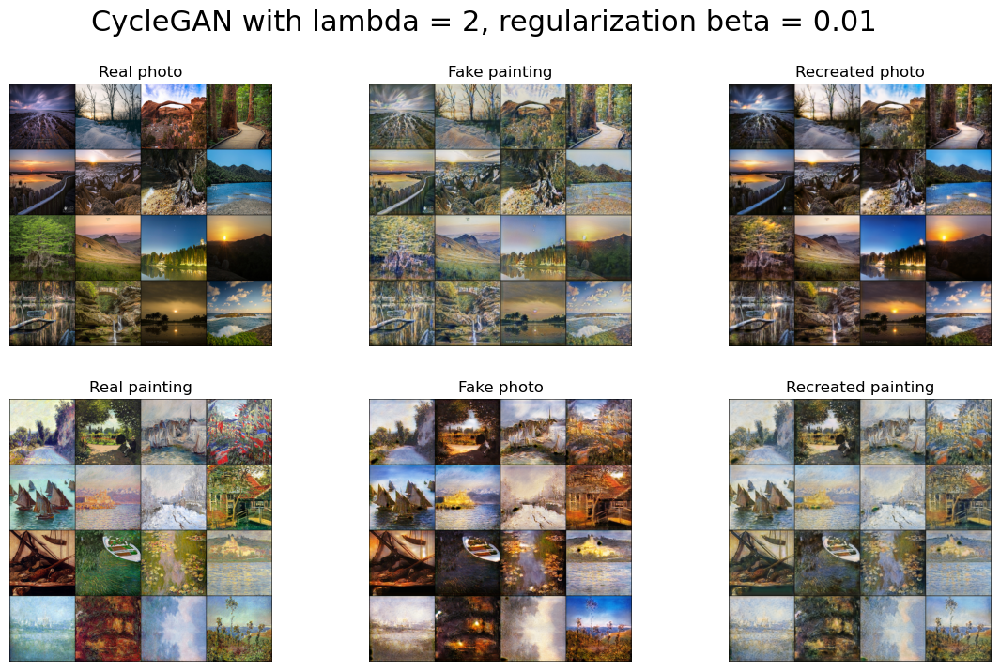

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


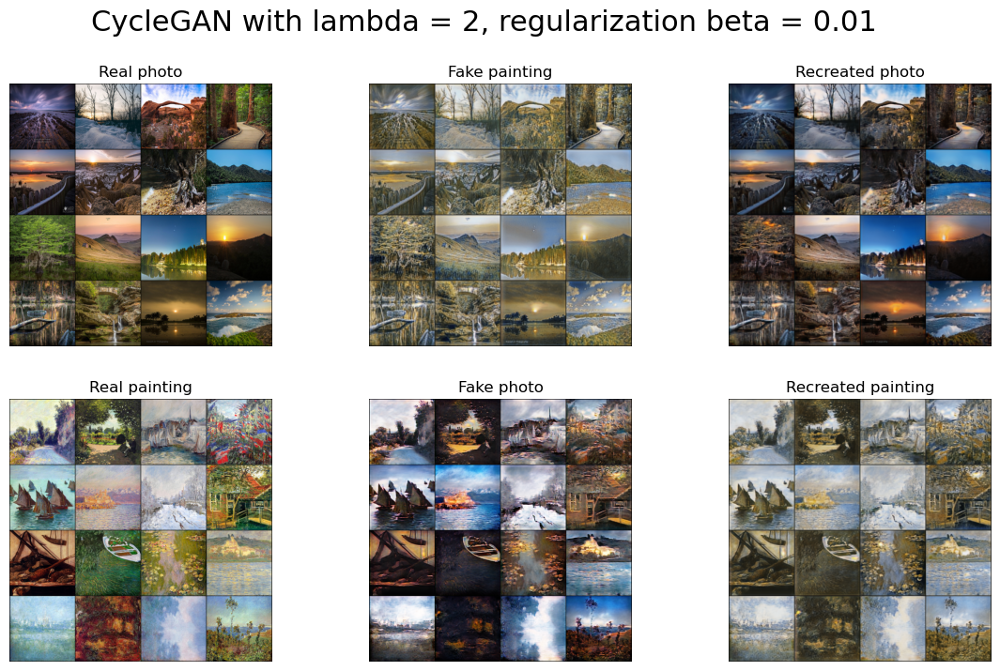

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


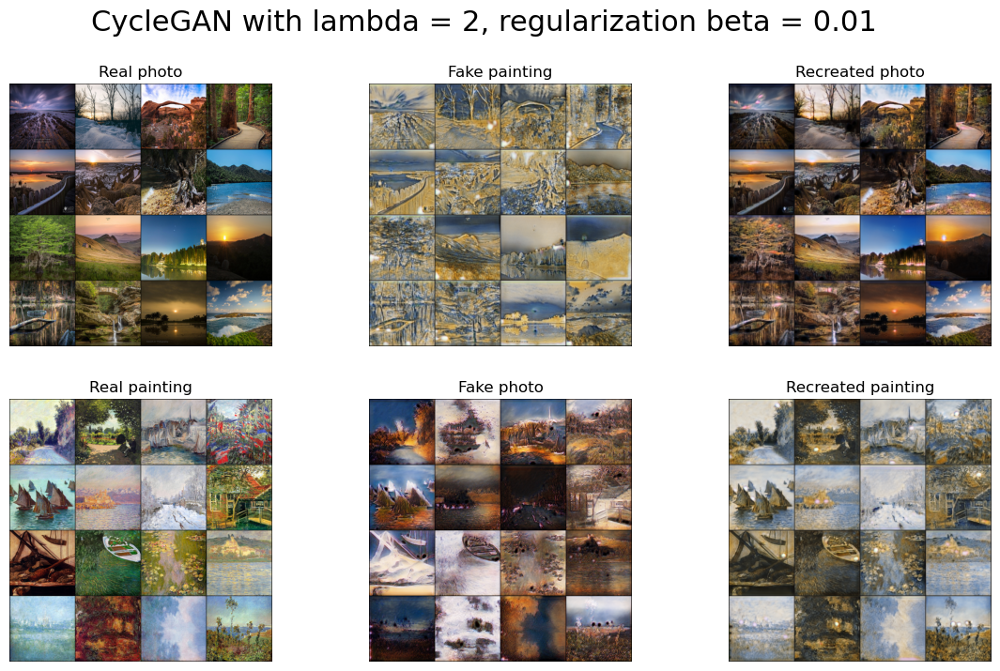

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


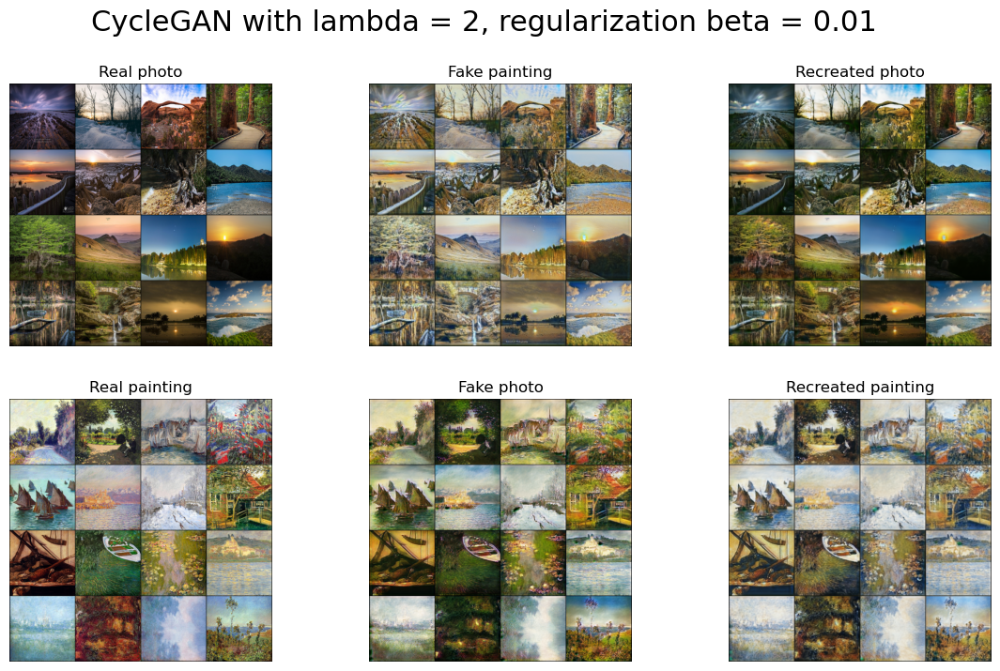

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


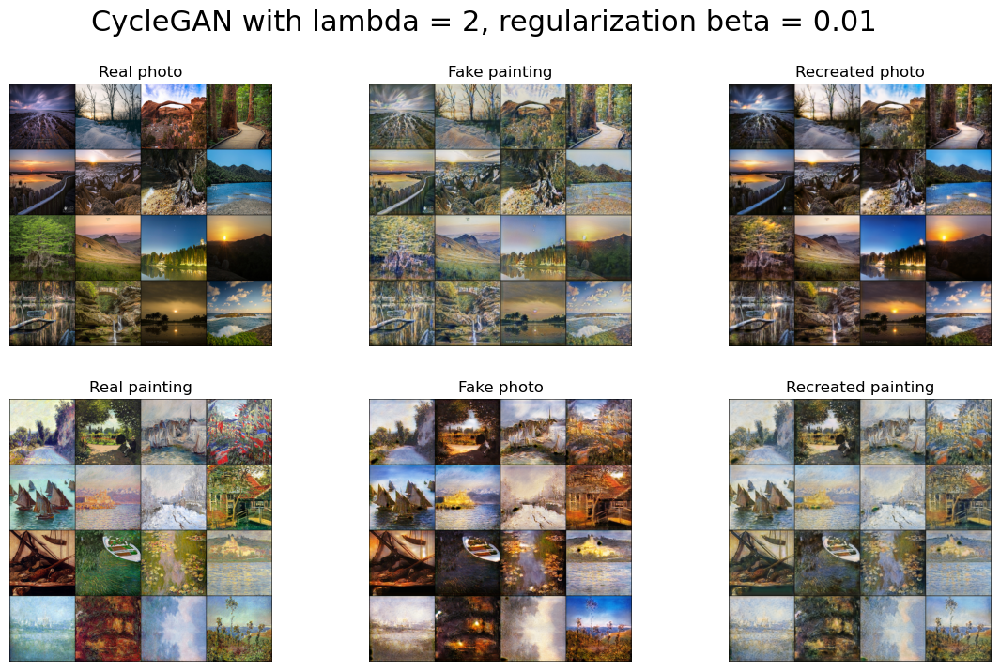

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


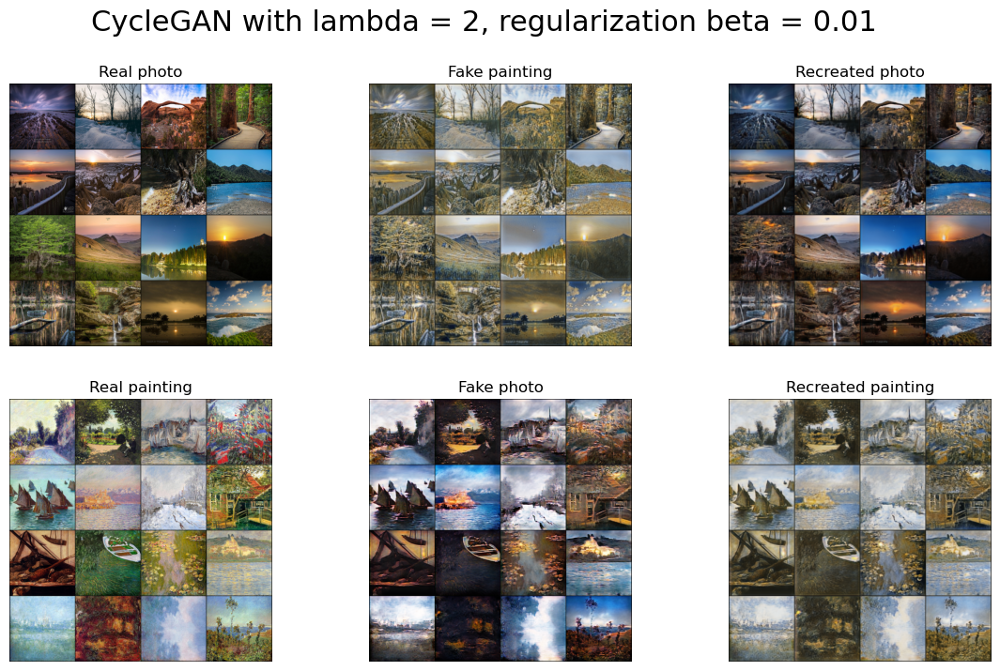

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


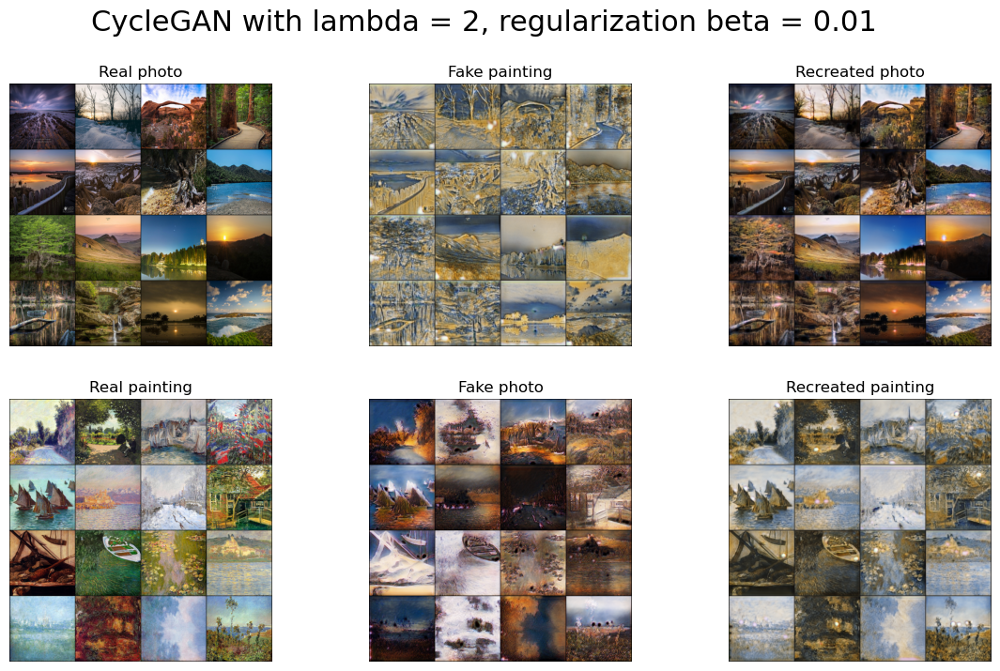

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_0/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


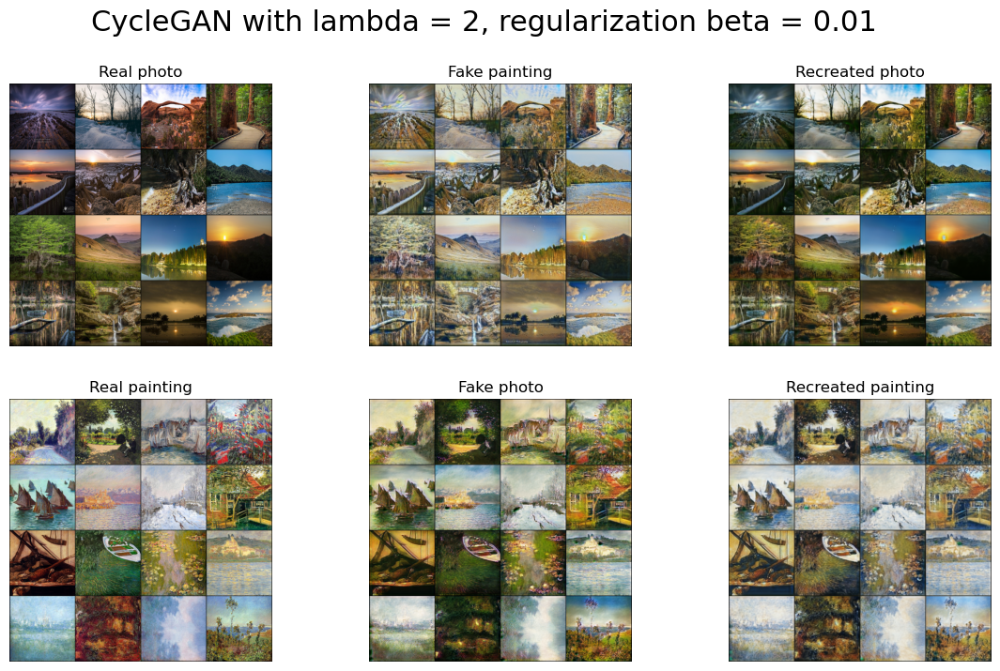

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_1/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


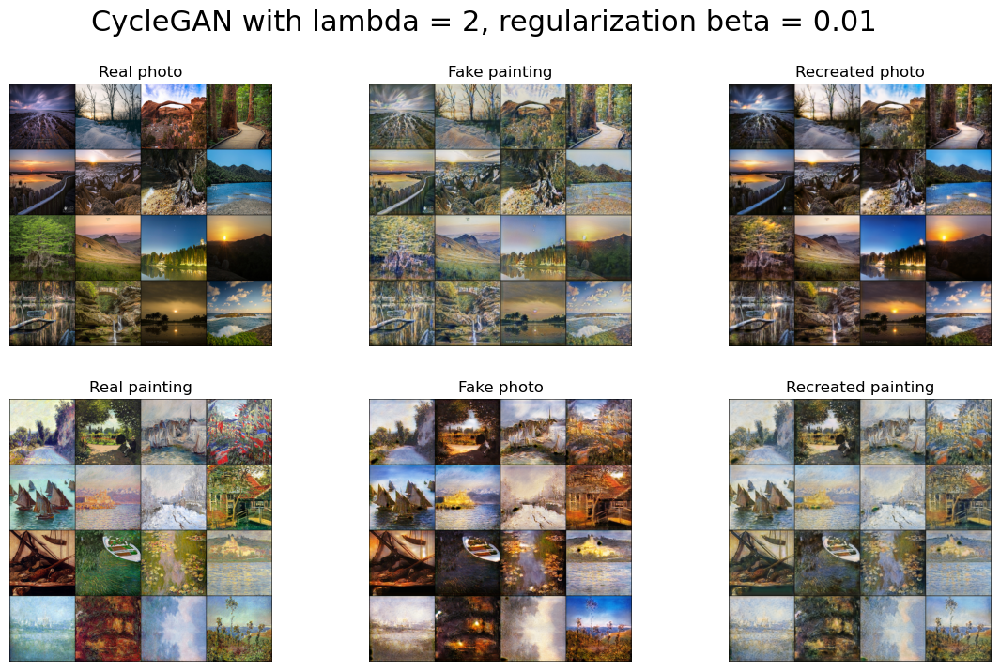

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_2/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


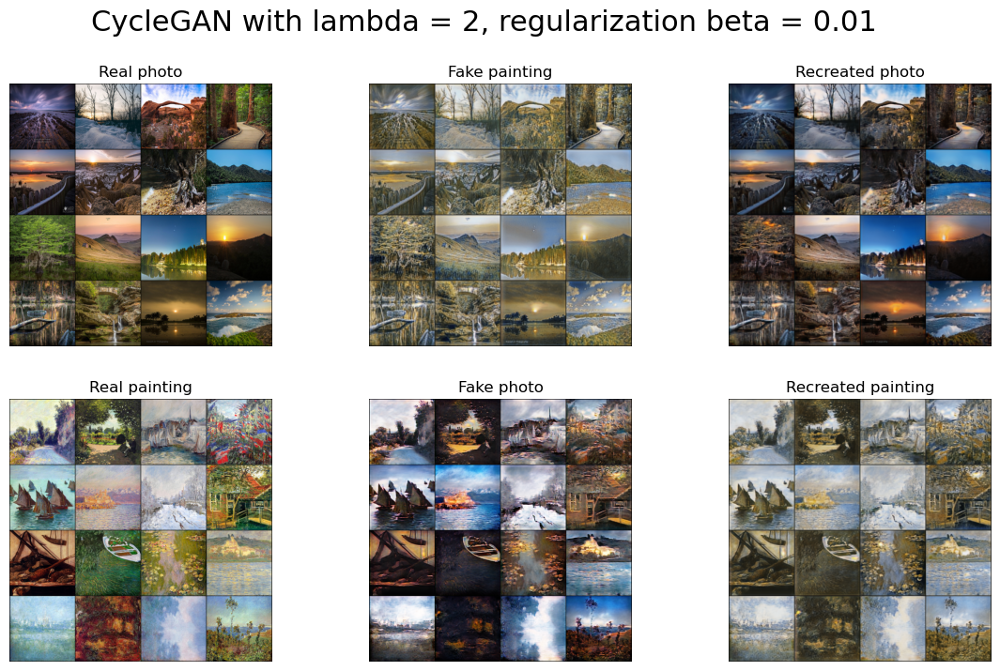

../models/regularization/lightning_logs/cyclegan_regularization_experiment_l2/version_3/checkpoints/checkpoint_periodic-epoch=0029.ckpt
0.01
2


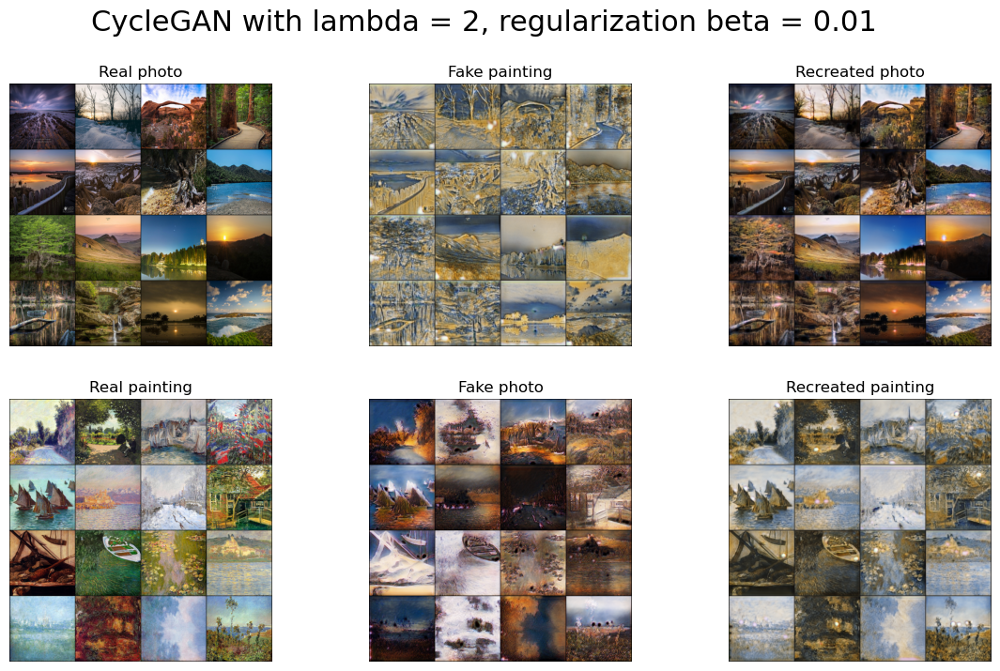

In [17]:
lambda_dirs = [regularization_log_dir / f"cyclegan_regularization_experiment_l{l}" for l in lambdas]


class TestSemanticRegularization(SemanticRegularization):
    # PL only needs `TestSemanticRegularization` to be defined in current scope, the actual class
    pass


for lambda_dir in lambda_dirs:
    for subdir in iter(sorted(lambda_dirs[3].iterdir())):
        path = next((subdir / "checkpoints").iterdir())
        print(path)
        model = CycleGAN.load_from_checkpoint(path)
        print(model.regularization.beta_param)
        print(model.lambda_param)

        show_images(
            model,
            f"CycleGAN with lambda = {model.lambda_param}, regularization beta = {model.regularization.beta_param}",
        )